<a href="https://colab.research.google.com/github/Okutobe/Metric_Analytics/blob/main/Capstone_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Install all packages
!pip install prophet
!pip install hvplot
!pip install holoviews
!pip install panel
!pip install mplfinance

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 19.5 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 73.1/73.1 kB 2.8 MB/s eta 0:00:00


In [67]:
# Import Packages
import pandas as pd
import hvplot.pandas
import datetime as dt
import holoviews as hv
from prophet import Prophet
import panel
import numpy as np
import math 
import mplfinance as mpl
import matplotlib.pyplot as plt
import requests 
from math import floor
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from statsmodels.tsa.arima.model import ARIMA


In [4]:
# Import the files library to allow files upload
from google.colab import files
uploaded = files.upload()

sales_data = pd.read_csv("Walmart_Store_sales.csv")


Saving Walmart_Store_sales.csv to Walmart_Store_sales.csv


In [68]:
# Filter data by the Store number
filtered_df = sales_data.reset_index(drop=True)
store_1 = filtered_df[filtered_df.Store==1]
store_2 = filtered_df[filtered_df.Store==2]

In [ ]:
# Now were going to run our test data based off the the years 2010 and 2011.

In [69]:
filtered_df['Date'] = pd.to_datetime(filtered_df['Date'], format='%d-%m-%Y')

# set the 'Date' column as the index
filtered_df.set_index('Date', inplace=True)

# drop all rows with dates after 12-31-2011
filtered_df = filtered_df.loc['2011-12-31':]

data_2012 = filtered_df.reset_index()

data_2012.tail()

<ipython-input-69-acf2a3a02449>:7: FutureWarning: Value based partial slicing on non-monotonic DatetimeIndexes with non-existing keys is deprecated and will raise a KeyError in a future Version.
  filtered_df = filtered_df.loc['2011-12-31':]


,Date,Store,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
1930,2012-09-28,45,713173.95,0,64.88,3.997,192.013558,8.684
1931,2012-10-05,45,733455.07,0,64.89,3.985,192.170412,8.667
1932,2012-10-12,45,734464.36,0,54.47,4.000,192.327265,8.667
1933,2012-10-19,45,718125.53,0,56.47,3.969,192.330854,8.667
1934,2012-10-26,45,760281.43,0,58.85,3.882,192.308899,8.667


In [70]:
filtered_df = sales_data.reset_index(drop=True)


In [71]:
# Convert the 'Date' column to datetime format
filtered_df['Date'] = pd.to_datetime(filtered_df['Date'], format='%d-%m-%Y')


# reset the index
test_data = filtered_df.reset_index()

# set the 'Date' column as the index
filtered_df.set_index('Date', inplace=True)

# drop all rows with dates after 12-31-2011
filtered_df = filtered_df.loc[:'2011-12-31']

# reset the index
test_data = filtered_df.reset_index()



In [72]:
test_data.tail()

,Date,Store,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
4495,2011-12-02,45,875699.81,0,50.19,3.452,188.502435,8.523
4496,2011-12-09,45,957155.31,0,46.57,3.415,188.654469,8.523
4497,2011-12-16,45,1078905.68,0,39.93,3.413,188.797935,8.523
4498,2011-12-23,45,1521957.99,0,42.27,3.389,188.929975,8.523
4499,2011-12-30,45,869403.63,1,37.79,3.389,189.062016,8.523


In [73]:
data_2012

,Date,Store,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
0,2012-01-06,1,1550369.92,0,49.01,3.157,219.714258,7.348
1,2012-01-13,1,1459601.17,0,48.53,3.261,219.892526,7.348
2,2012-01-20,1,1394393.84,0,54.11,3.268,219.985689,7.348
3,2012-01-27,1,1319325.59,0,54.26,3.290,220.078852,7.348
4,2012-02-03,1,1636339.65,0,56.55,3.360,220.172015,7.348
...,...,...,...,...,...,...,...,...
1930,2012-09-28,45,713173.95,0,64.88,3.997,192.013558,8.684
1931,2012-10-05,45,733455.07,0,64.89,3.985,192.170412,8.667
1932,2012-10-12,45,734464.36,0,54.47,4.000,192.327265,8.667
1933,2012-10-19,45,718125.53,0,56.47,3.969,192.330854,8.667


In [74]:
filtered_df = sales_data.reset_index(drop=True)

for i in range(1, 46):
    store_name = f'store_{i}'
    globals()[store_name] = filtered_df[filtered_df.Store == i]


In [75]:
# Initialize a dictionary to store the total sales for each store
store_sales = {}

# Loop over all store numbers
for store in range(1, 46):
    # Get the rows for the current store
    store_df = test_data[test_data['Store'] == store]
    # Sum the weekly sales for the current store
    total_sales = store_df['Weekly_Sales'].sum()
    # Add the total sales to the dictionary
    store_sales[store] = total_sales

# Sort the dictionary by its values in descending order
sorted_sales = sorted(store_sales.items(), key=lambda x: x[1], reverse=True)

# Get the top 5 highest revenue generating stores
top_5_stores = sorted_sales[:5]

# Get the bottom 5 lowest revenue generating stores
bottom_5_stores = sorted_sales[-5:]

# Print the results
print('Top 5 highest revenue generating stores:')
for store, sales in top_5_stores:
    print(f'Store {store}: {sales:,.2f}')

print('Bottom 5 lowest revenue generating stores:')
for store, sales in bottom_5_stores:
    print(f'Store {store}: {sales:,.2f}')

Top 5 highest revenue generating stores:
Store 20: 211,570,083.08
Store 14: 211,558,513.08
Store 4: 206,772,764.14
Store 13: 199,810,248.78
Store 2: 193,885,745.61
Bottom 5 lowest revenue generating stores:
Store 3: 39,562,295.57
Store 38: 36,528,552.97
Store 5: 31,306,850.77
Store 44: 29,105,714.12
Store 33: 25,724,670.93


<ipython-input-76-fc7340cee9d0>:9: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for store, revenue in revenue_by_store.iteritems():


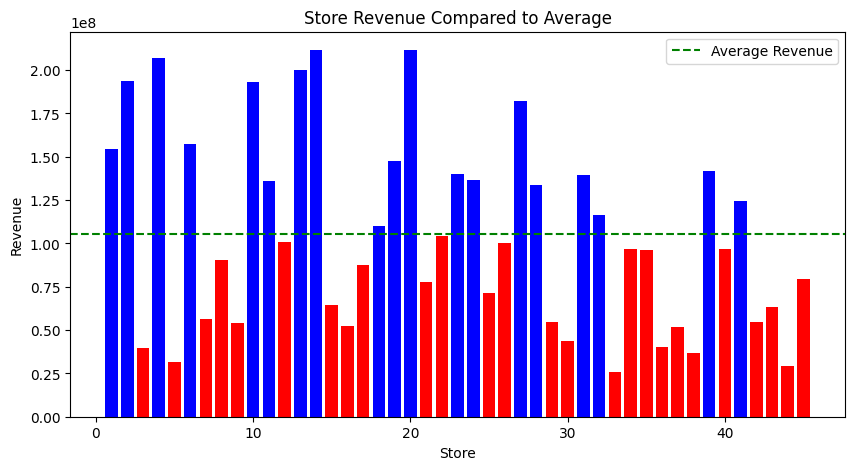

In [76]:
# Group the data by store number and calculate the total revenue for each store
revenue_by_store = test_data.groupby('Store')['Weekly_Sales'].sum()

# Calculate the average revenue across all stores
avg_revenue = revenue_by_store.mean()

# Plot the revenue for each store compared to the average
plt.figure(figsize=(10,5))
for store, revenue in revenue_by_store.iteritems():
    plt.bar(store, revenue, color='b' if revenue > avg_revenue else 'r')
plt.axhline(avg_revenue, color='g', linestyle='--', label='Average Revenue')
plt.legend()
plt.xlabel('Store')
plt.ylabel('Revenue')
plt.title('Store Revenue Compared to Average')
plt.show()

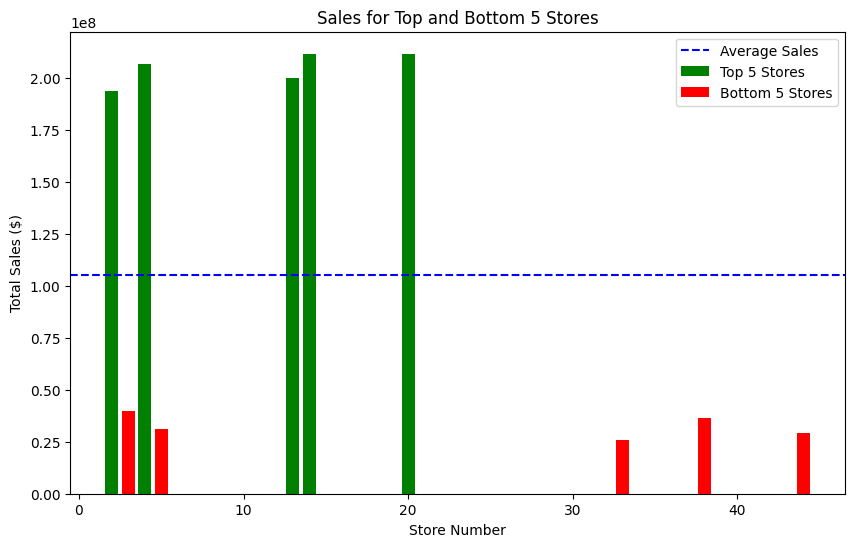

In [77]:
# Calculate the average sales for all 45 stores
avg_sales = sum(store_sales.values()) / len(store_sales)

# Initialize lists to store the store numbers and sales for the top and bottom 5 stores
top_store_nums = []
top_store_sales = []
bottom_store_nums = []
bottom_store_sales = []

# Loop over the top 5 highest revenue generating stores
for store, sales in top_5_stores:
    top_store_nums.append(store)
    top_store_sales.append(sales)

# Loop over the bottom 5 lowest revenue generating stores
for store, sales in bottom_5_stores:
    bottom_store_nums.append(store)
    bottom_store_sales.append(sales)

# Plot the sales for the top and bottom 5 stores
plt.figure(figsize=(10, 6))
plt.bar(top_store_nums, top_store_sales, color='g', label='Top 5 Stores')
plt.bar(bottom_store_nums, bottom_store_sales, color='r', label='Bottom 5 Stores')
plt.axhline(y=avg_sales, color='b', linestyle='--', label='Average Sales')
plt.xlabel('Store Number')
plt.ylabel('Total Sales ($)')
plt.title('Sales for Top and Bottom 5 Stores')
plt.legend()
plt.show()



In [ ]:
# As you can see Top 5 highest revenue generating stores:
Store 20: 211,570,083.08
Store 14: 211,558,513.08
Store 4: 206,772,764.14
Store 13: 199,810,248.78
Store 2: 193,885,745.61

Bottom 5 lowest revenue generating stores:
Store 3: 39,562,295.57
Store 38: 36,528,552.97
Store 5: 31,306,850.77
Store 44: 29,105,714.12
Store 33: 25,724,670.93

<ipython-input-33-3b8fc21c0b39>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = sales_data.corr()


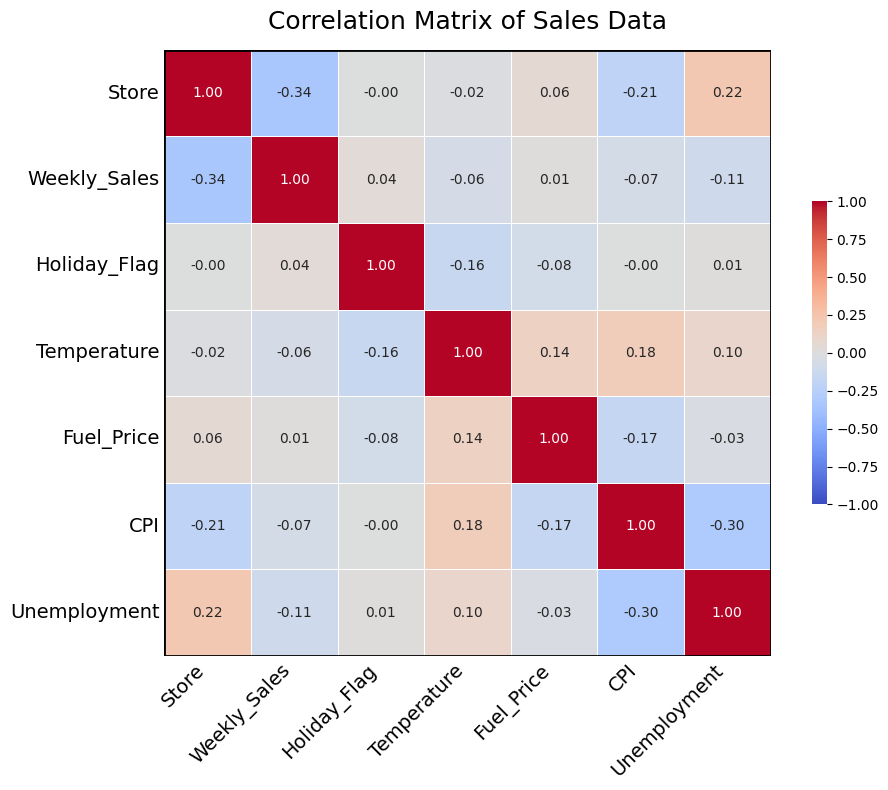

In [ ]:
# Compute the correlation matrix
corr_matrix = sales_data.corr()

# Set up the figure
fig, ax = plt.subplots(figsize=(10, 8))

# Create the heatmap
sns.heatmap(corr_matrix, 
            annot=True, 
            fmt='.2f', 
            cmap='coolwarm', 
            vmin=-1, vmax=1, 
            center=0,
            square=True, 
            linewidths=.5, 
            cbar_kws={"shrink": .5}, 
            ax=ax)

# Customize the plot
ax.set_title('Correlation Matrix of Sales Data', fontsize=18, pad=15)
ax.tick_params(axis='both', labelsize=14, length=0)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right', fontsize=14)
ax.set_yticklabels(ax.get_yticklabels(), rotation=0, va='center', fontsize=14)
ax.axhline(y=0, color='k', linewidth=2)
ax.axhline(y=corr_matrix.shape[1], color='k', linewidth=2)
ax.axvline(x=0, color='k', linewidth=2)
ax.axvline(x=corr_matrix.shape[0], color='k', linewidth=2)

# Show the plot
plt.tight_layout()
plt.show()

<ipython-input-82-f459aa5645e7>:6: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = sales_data.corr()


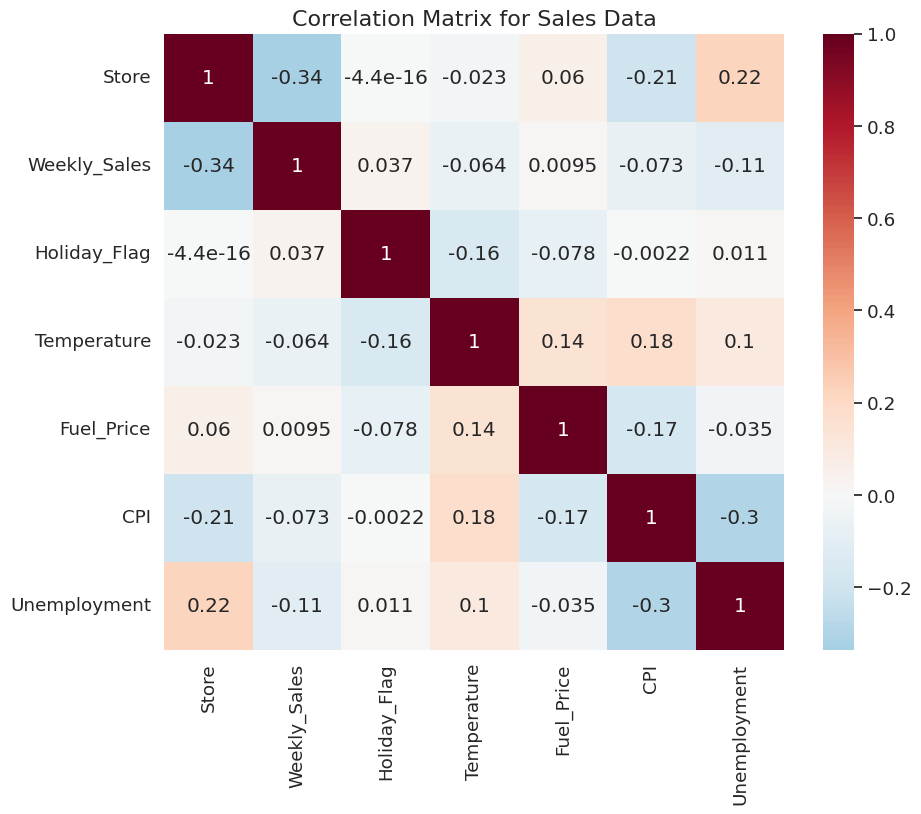

In [82]:

# Import necessary libraries
import seaborn as sns
import matplotlib.pyplot as plt

# Create correlation matrix
corr_matrix = sales_data.corr()

# Set up heatmap figure
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.2)
sns.set_style('whitegrid')

# Create heatmap with annotations and diverging color scheme
sns.heatmap(corr_matrix, annot=True, cmap='RdBu_r', center=0)

# Add title to heatmap
plt.title('Correlation Matrix for Sales Data', fontsize=16)

# Display heatmap
plt.show()


In [83]:
# Split the data into features (predictors) and target variable (weekly sales)
X = test_data[['Temperature', 'Fuel_Price', 'CPI']]
y = test_data['Weekly_Sales']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create a linear regression model and train it on the training set
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the testing set
y_pred = model.predict(X_test)

# Calculate the mean squared error (MSE) of the predictions
mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error:", mse)


Mean Squared Error: 315387107827.21796


In [84]:
# Calculate the total revenue for each store
revenue = test_data.groupby('Store')['Weekly_Sales'].sum().sort_values(ascending=False)

# Get the store numbers for the top 5 highest and lowest revenue stores
top_stores = revenue.head(5).index
bottom_stores = revenue.tail(5).index

# Loop over the top 5 highest revenue stores
for store in top_stores:

    # Filter the data for the current store
    store_data = test_data[test_data['Store'] == store]

    # Split the data into features (predictors) and target variable (weekly sales)
    X = store_data[['Temperature', 'Fuel_Price', 'CPI']]
    y = store_data['Weekly_Sales']

    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Create a linear regression model and train it on the training set
    model = LinearRegression()
    model.fit(X_train, y_train)

    # Make predictions on the testing set
    y_pred = model.predict(X_test)

    # Make predictions for the future period
    future_X = test_data[test_data['Store'] == store][['Temperature', 'Fuel_Price', 'CPI']].iloc[len(test_data):]
    future_dates = future_X.index
    future_pred = model.predict(future_X)

    # Plot the actual and predicted weekly sales over time
    plt.plot(store_data['Date'], store_data['Weekly_Sales'], label='Actual')
    plt.plot(X_test.index, y_pred, label='Predicted (Test Data)')
    plt.plot(future_dates, future_pred, label='Predicted (Future Data)')
    plt.xlabel('Date')
    plt.ylabel('Weekly Sales')
    plt.title(f'Store {store} Actual vs. Predicted Weekly Sales')
    plt.legend()
    plt.show()

# Loop over the bottom 5 lowest revenue stores
for store in bottom_stores:

    # Filter the data for the current store
    store_data = test_data[test_data['Store'] == store]

    # Split the data into features (predictors) and target variable (weekly sales)
    X = store_data[['Temperature', 'Fuel_Price', 'CPI']]
    y = store_data['Weekly_Sales']

    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Create a linear regression model and train it on the training set
    model = LinearRegression()
    model.fit(X_train, y_train)

    # Make predictions on the testing set
    y_pred = model.predict(X_test)

    # Make predictions for the future period
    future_X = data[data['Store'] == store][['Temperature', 'Fuel_Price', 'CPI']].iloc[len(test_data):]
    future_dates = future_X.index
    future_pred = model.predict(future_X)

    # Plot the actual and predicted weekly sales over time
    plt.plot(store_data['Date'], store_data['Weekly_Sales'], label='Actual')
    plt.plot(X_test.index, y_pred, label='Predicted')

ValueError: ignored

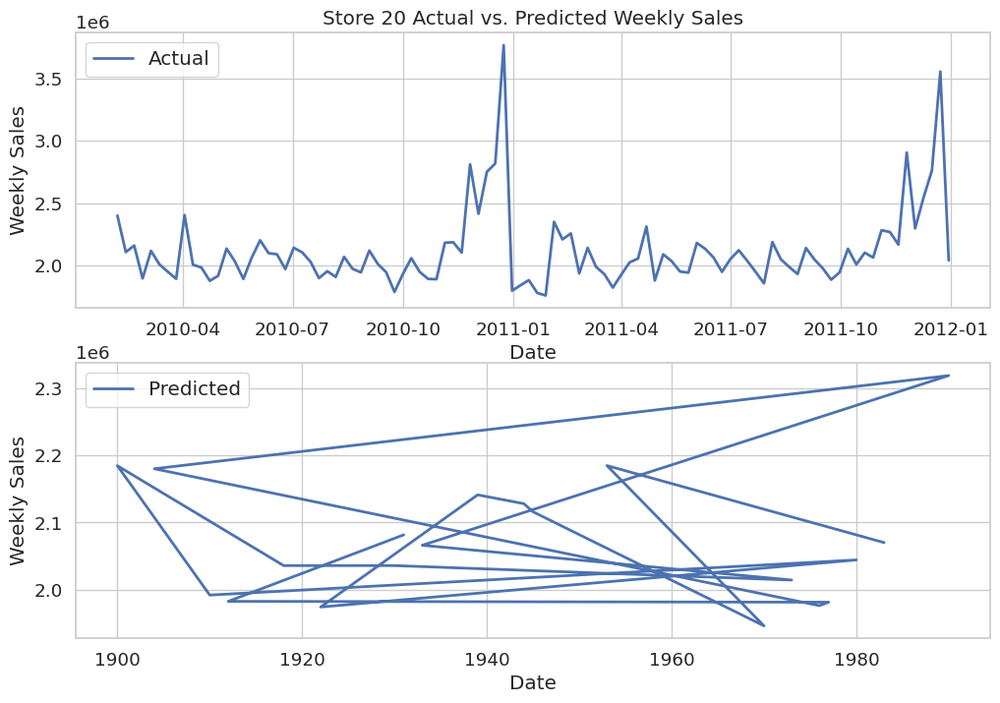

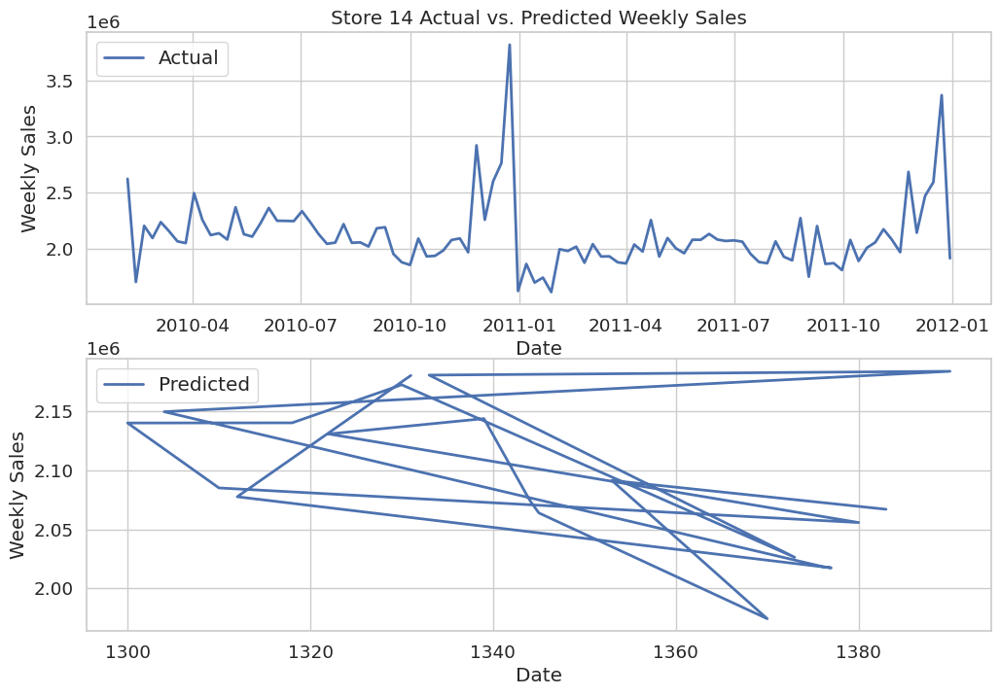

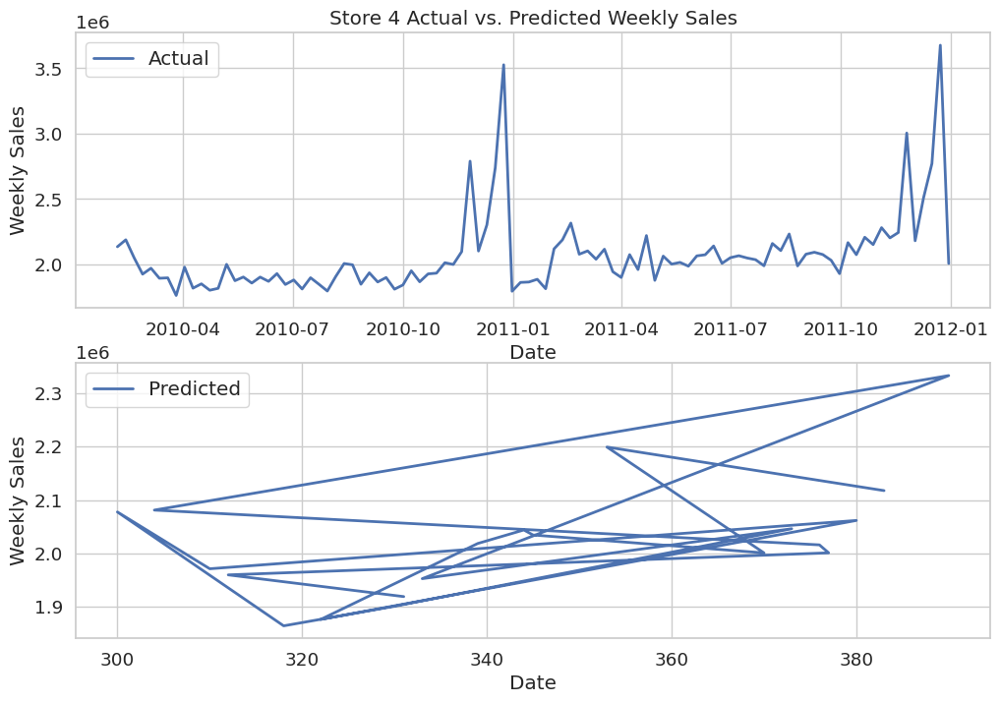

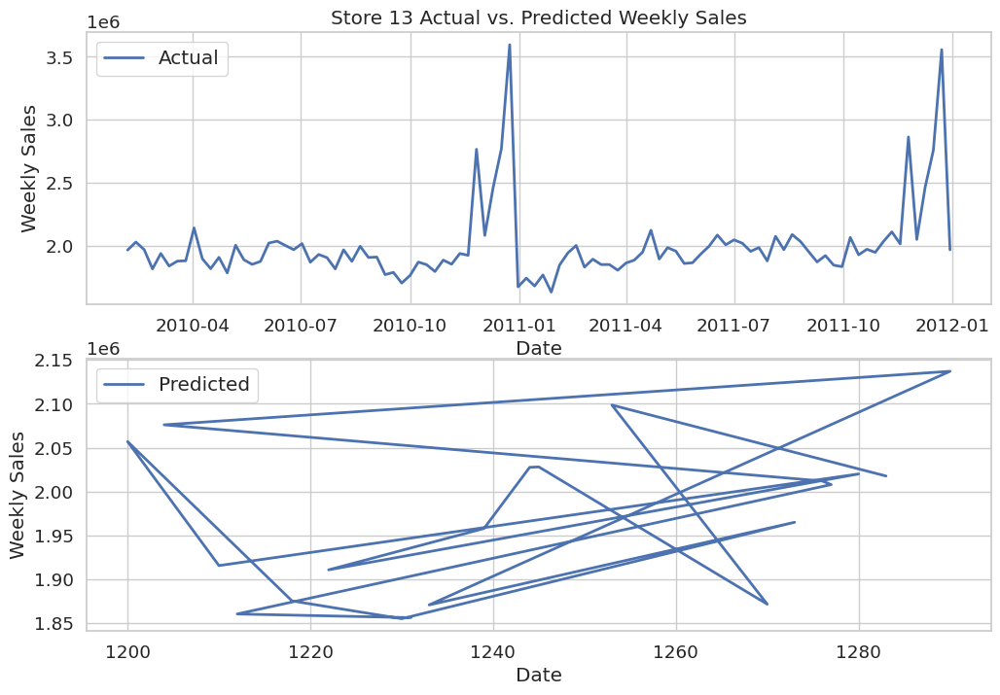

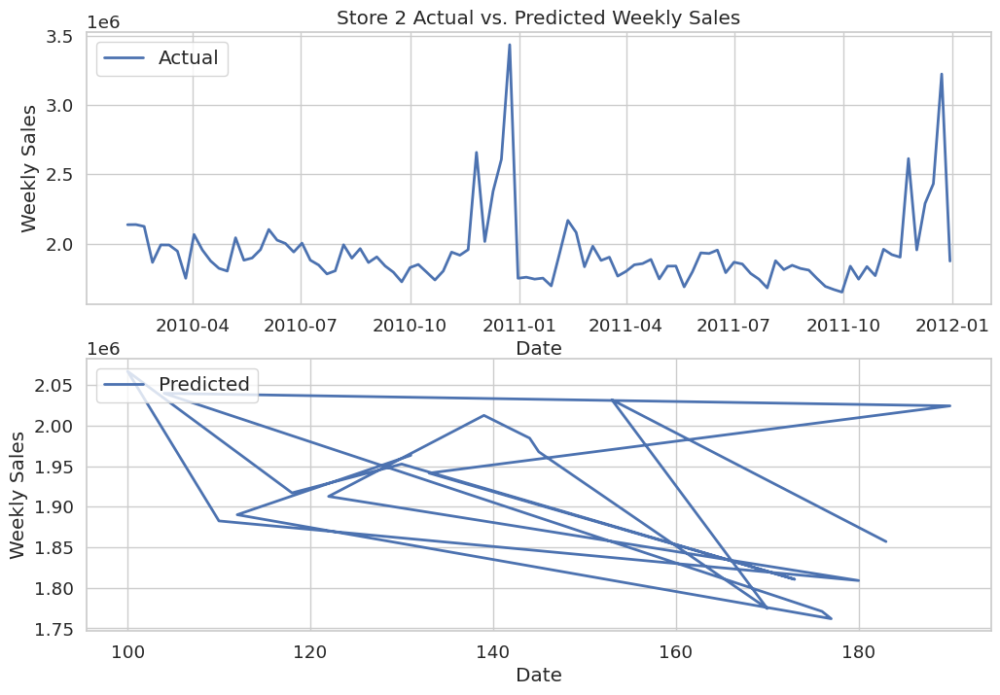

In [93]:
# Loop over the top 5 highest revenue stores
for store in top_stores:

    # Filter the data for the current store
    store_data = test_data[test_data['Store'] == store]

    if len(store_data) > 0:  # Check if there is data available for the current store

        # Split the data into features (predictors) and target variable (weekly sales)
        X = store_data[['Temperature', 'Fuel_Price', 'CPI']]
        y = store_data['Weekly_Sales']

        # Split the data into training and testing sets
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

        # Create a linear regression model and train it on the training set
        model = LinearRegression()
        model.fit(X_train, y_train)

        # Make predictions on the testing set
        y_pred = model.predict(X_test)

        # Set up the plot with two subplots
        fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 8))

        # Plot the actual weekly sales over time
        ax1.plot(store_data['Date'], store_data['Weekly_Sales'], label='Actual', linewidth=2)
        ax1.set_xlabel('Date')
        ax1.set_ylabel('Weekly Sales')
        ax1.set_title(f'Store {store} Actual vs. Predicted Weekly Sales')
        ax1.legend(loc='upper left', fontsize='medium')

        # Plot the predicted weekly sales over time
        ax2.plot(X_test.index, y_pred, label='Predicted', linewidth=2)
        ax2.set_xlabel('Date')
        ax2.set_ylabel('Weekly Sales')
        ax2.legend(loc='upper left', fontsize='medium')

        # Show the plot
        plt.show()


ConversionError: ignored

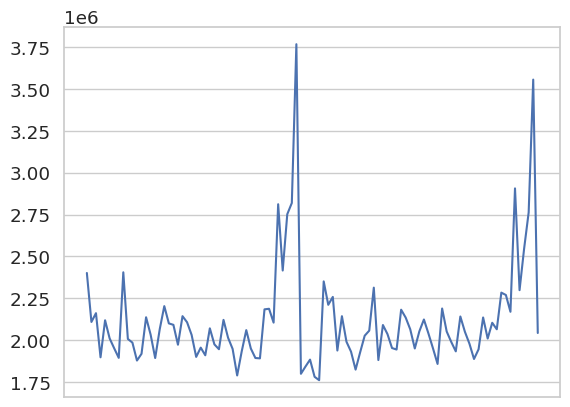

In [96]:
# Loop over the top 5 highest revenue stores
for store in top_stores:

    # Filter the data for the current store
    store_data = test_data[test_data['Store'] == store]

    if len(store_data) > 0:  # Check if there is data available for the current store

        # Split the data into features (predictors) and target variable (weekly sales)
        X = store_data[['Temperature', 'Fuel_Price', 'CPI']]
        y = store_data['Weekly_Sales']

        # Split the data into training and testing sets
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

        # Create a linear regression model and train it on the training set
        model = LinearRegression()
        model.fit(X_train, y_train)

        # Create new data for 2012
        new_data = pd.DataFrame({'Temperature': [65, 67, 70, 72, 75], 
                                 'Fuel_Price': [2.80, 2.85, 2.90, 2.95, 3.00],
                                 'CPI': [220, 222, 225, 228, 230],
                                 'Date': ['01-01-2012', '08-01-2012', '15-01-2012', '22-01-2012', '29-01-2012']})

        # Set the date column as the index
        new_data.set_index('Date', inplace=True)

        # Make predictions on the new data
        y_pred = model.predict(new_data)

        # Plot the actual weekly sales for 2010 and 2011
        plt.plot(store_data[store_data['Date'].dt.year.isin([2010, 2011])]['Date'], 
                 store_data[store_data['Date'].dt.year.isin([2010, 2011])]['Weekly_Sales'], label='Actual')

        # Plot the predicted weekly sales for 2012
        plt.plot(new_data.index, y_pred, label='Predicted')
        plt.xlabel('Date')
        plt.ylabel('Weekly Sales')
        plt.title(f'Store {store} Actual vs. Predicted Weekly Sales')
        plt.legend()
        plt.show()



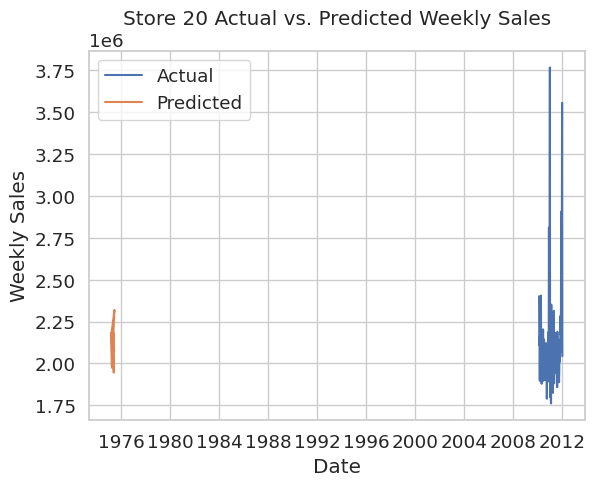

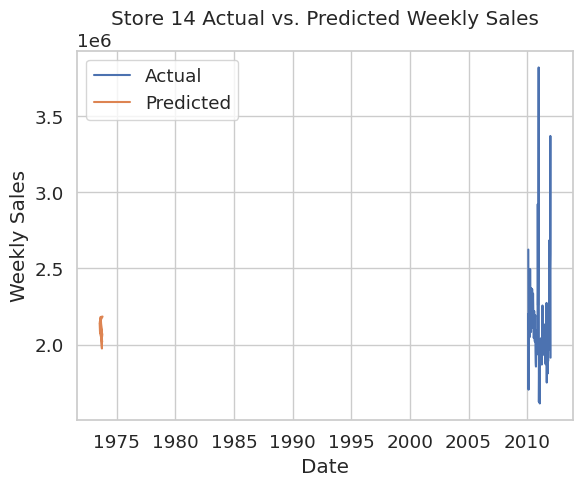

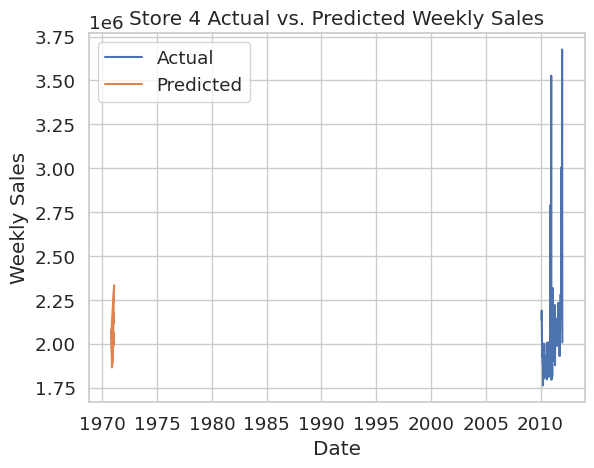

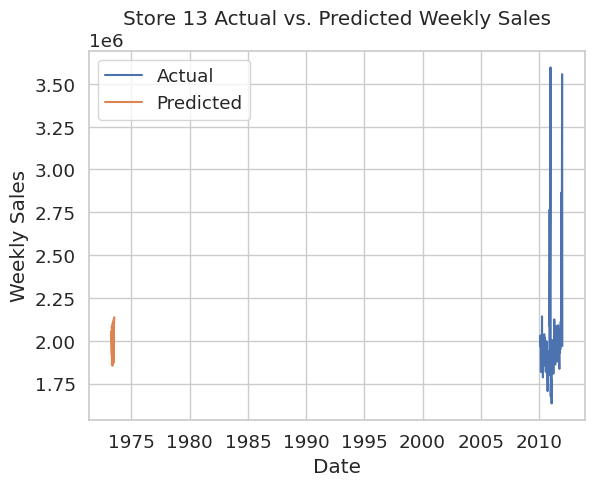

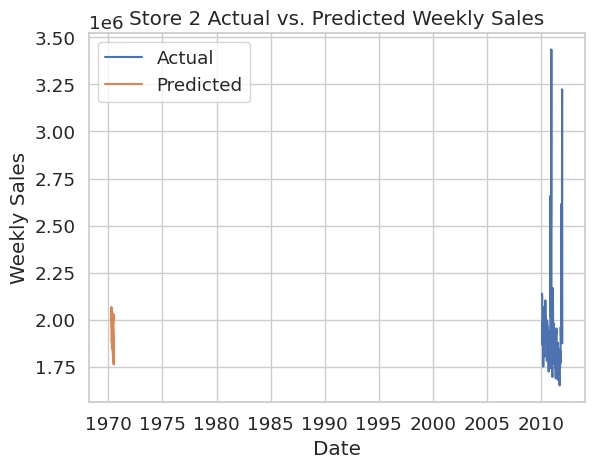

In [89]:
# Loop over the top 5 highest revenue stores
for store in top_stores:

    # Filter the data for the current store
    store_data = test_data[test_data['Store'] == store]

    if len(store_data) > 0:  # Check if there is data available for the current store

        # Split the data into features (predictors) and target variable (weekly sales)
        X = store_data[['Temperature', 'Fuel_Price', 'CPI']]
        y = store_data['Weekly_Sales']

        # Split the data into training and testing sets
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

        # Create a linear regression model and train it on the training set
        model = LinearRegression()
        model.fit(X_train, y_train)

        # Make predictions on the testing set
        y_pred = model.predict(X_test)

        # Plot the actual and predicted weekly sales over time
        plt.plot(store_data['Date'], store_data['Weekly_Sales'], label='Actual')
        plt.plot(X_test.index, y_pred, label='Predicted')
        plt.xlabel('Date')
        plt.ylabel('Weekly Sales')
        plt.title(f'Store {store} Actual vs. Predicted Weekly Sales')
        plt.legend()
        plt.show()


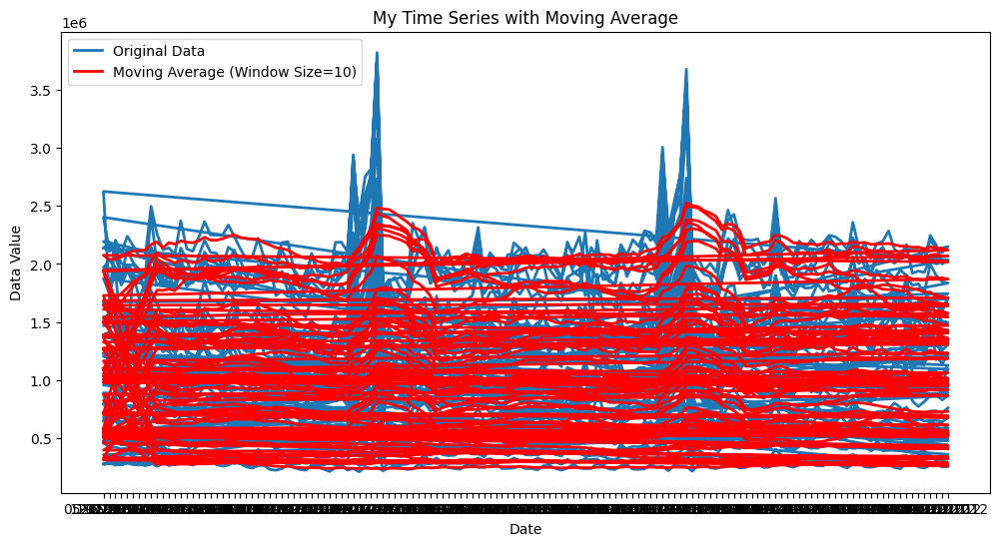

In [ ]:
v# Set the size of the moving average window
window_size = 10

# Calculate the moving average of the 'my_column' column
moving_average = sales_data['Weekly_Sales'].rolling(window_size).mean()

# Add the moving average as a new column to the DataFrame
sales_data['moving_average'] = moving_average

# Set up the plot
fig, ax = plt.subplots(figsize=(12, 6))

# Plot the original data
ax.plot(sales_data['Date'], sales_data['Weekly_Sales'], label='Original Data', linewidth=2)

# Plot the moving average
ax.plot(sales_data['Date'], sales_data['moving_average'], label=f'Moving Average (Window Size={window_size})', color='red', linewidth=2)

# Customize the plot
ax.set_xlabel('Date')
ax.set_ylabel('Data Value')
ax.set_title('My Time Series with Moving Average')
ax.legend(loc='upper left', fontsize='medium')

# Show the plot
plt.show()

In [ ]:
# toatal revenue, and total revenue per store on a bar chart 

In [ ]:
# show a week by week roling average and how the CPI relates to weekly sales 

In [ ]:
# Show any corolation between holidays and an increse it sales (how much... be precice )

In [ ]:
# Pic the most succsesfull store, and the least, show how they compare to the average of the 45. (line chart?)

In [ ]:
# rainbow :) (do this)

In [ ]:
## How do holidays effect weekly sales and 

In [ ]:
#total revenue per store bar chart 



In [ ]:
# top 5
# bottom 5 

In [ ]:
# with moving average rolling average  
#.rolling(window=long_window).mean()

In [ ]:
from google.colab import files
uploaded = files.upload()

# df_mercado_trends = # YOUR CODE HERE
# Review the first and last five rows of the DataFrame
# YOUR CODE HERE
# then store in a Pandas DataFrame
# Set the "Date" column as the Datetime Index.

df_mercado_trends = pd.read_csv("google_hourly_search_trends.csv",
                 index_col="Date",
                 infer_datetime_format=True,
                 parse_dates=True
                )

# Review the first and last five rows of the DataFrame
df_mercado_trends.head()
df_mercado_trends.tail()

SyntaxError: ignored

In [ ]:
# Pull data from Yahoo Finance
symbol = 'GOOG', 'MSFT'
timeframe = '5Y'
stock_data = yf.download(symbol, period=timeframe)
stock_data.tail()

[*********************100%***********************]  2 of 2 completed


Adj Close                   Close                    High  \
                  GOOG        MSFT        GOOG        MSFT        GOOG   
Date                                                                     
2023-04-18  105.120003  288.369995  105.120003  288.369995  107.050003   
2023-04-19  105.019997  288.450012  105.019997  288.450012  105.724998   
2023-04-20  105.900002  286.109985  105.900002  286.109985  106.888000   
2023-04-21  105.910004  285.760010  105.910004  285.760010  106.639999   
2023-04-24  106.779999  281.769989  106.779999  281.769989  107.320000   

                               Low                    Open              \
                  MSFT        GOOG        MSFT        GOOG        MSFT   
Date                                                                     
2023-04-18  291.760010  104.779999  287.010010  107.000000  291.570007   
2023-04-19  289.049988  103.800003  284.540009  104.214996  285.989990   
2023-04-20  289.029999  104.639999  285.079987  104.650002  285.250000   
2023-04-21  286.269989  105.485001  283.059998  106.089996  285.010010   
2023-04-24  284.950012  105.360001  278.720001  106.050003  282.089996   

              Volume            
                GOOG      MSFT  
Date                            
2023-04-18  17641400  20161800  
2023-04-19  16732000  17150300  
2023-04-20  22515300  23244400  
2023-04-21  22369800  21665400  
2023-04-24  21390000  26590300

In [ ]:
#Drop all columns that arent needed
df = stock_data.drop(['High','Low','Adj Close','Volume','Open'], axis=1)
df

Close            
                  AAPL        MSFT
Date                              
2018-04-23   41.310001   95.349998
2018-04-24   40.735001   93.120003
2018-04-25   40.912498   92.309998
2018-04-26   41.055000   94.260002
2018-04-27   40.580002   95.820000
...                ...         ...
2023-04-14  165.210007  286.140015
2023-04-17  165.229996  288.799988
2023-04-18  166.470001  288.369995
2023-04-19  167.630005  288.450012
2023-04-20  166.649994  286.109985

[1258 rows x 2 columns]

In [ ]:
df.dtypes

Close  AAPL    float64
       MSFT    float64
dtype: object

In [ ]:
# Plot the graph
hv.extension('bokeh')
df.hvplot.line()

In [ ]:
# Set short and long window variables
short_window = 50
long_window = 100

In [ ]:
# Create Simple Moving Average of SPY
spy_data['SMA50'] = stock_data['Close'].rolling(window=short_window).mean()
spy_data['SMA100'] = stock_data['Close'].rolling(window=long_window).mean()
display(spy_data.tail())

,Close,SMA50,SMA100
Date,,,
2023-03-07,398.269989,398.3068,392.6649
2023-03-08,398.920013,398.6708,393.0885
2023-03-09,391.559998,398.8438,393.3444
2023-03-10,385.910004,398.9340,393.6272
2023-03-13,385.359985,399.1080,393.8126


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
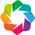

:NdOverlay   [Variable]
   :Curve   [Date]   (value)

In [ ]:
hv.extension('bokeh')
spy_data.hvplot.line()

In [ ]:
stock_data.head(10)

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2018-03-14,277.809998,278.019989,274.670013,275.299988,252.762100,105895100
2018-03-15,275.880005,276.609985,274.429993,275.000000,252.486557,83433000
2018-03-16,274.500000,275.390015,274.140015,274.200012,252.760437,100343700
2018-03-19,273.350006,274.399994,268.619995,270.489990,249.340454,109208400
2018-03-20,270.940002,271.670013,270.179993,270.950012,249.764542,59757300
2018-03-21,270.899994,273.269989,270.190002,270.429993,249.285126,78709600
2018-03-22,267.910004,268.869995,263.359985,263.670013,243.053757,148785900
2018-03-23,264.170013,264.540009,257.829987,258.049988,237.873138,183534800
2018-03-26,262.130005,265.429993,259.410004,265.109985,244.381104,141956100


In [ ]:
plt.style.use('fivethirtyeight')
plt.rcParams['figure.figsize'] = (20, 10)
#RSI stands for Relative strength Indicator
#if the stock goes up the RSI should go up and vice versa
#if it doesn't this indicates a divergence, especially at the higher timeframes
#again 70 is overbought and 30 is oversold
def get_rsi(close, lookback):
    ret = close.diff()
    up = []
    down = []
    for i in range(len(ret)):
        if ret[i] < 0:
            up.append(0)
            down.append(ret[i])
        else:
            up.append(ret[i])
            down.append(0)
    up_series = pd.Series(up)
    down_series = pd.Series(down).abs()
    up_ewm = up_series.ewm(com = lookback - 1, adjust = False).mean()
    down_ewm = down_series.ewm(com = lookback - 1, adjust = False).mean()
    rs = up_ewm/down_ewm
    rsi = 100 - (100 / (1 + rs))
    rsi_df = pd.DataFrame(rsi).rename(columns = {0:'rsi'}).set_index(close.index)
    rsi_df = rsi_df.dropna()
    return rsi_df[3:]

stock_data['rsi_09'] = get_rsi(stock_data['Close'], 9)
stock_data = stock_data.dropna()
stock_data['Overbought'] = 70
stock_data['Oversold'] = 30
stock_data['percent_b_high'] = 90
stock_data['percent_b_low'] = 10
stock_data.tail()

,Open,High,Low,Close,Adj Close,Volume,rsi_09,Overbought,Oversold,percent_b_high,percent_b_low
Date,,,,,,,,,,,
2023-03-07,404.420013,404.670013,397.630005,398.269989,398.269989,108310600,43.499490,70,30,90,10
2023-03-08,398.390015,399.709991,396.589996,398.920013,398.920013,74746600,44.876846,70,30,90,10
2023-03-09,399.739990,401.480011,390.529999,391.559998,391.559998,111945300,34.243430,70,30,90,10
2023-03-10,390.989990,393.160004,384.320007,385.910004,385.910004,189105300,28.426481,70,30,90,10
2023-03-13,381.809998,390.390015,380.670013,385.359985,385.359985,157468964,27.907301,70,30,90,10


In [ ]:
#Calculating True Range 
stock_data['tr0'] = abs(stock_data['High'] - stock_data['Low'])
stock_data['tr1'] = abs(stock_data['High'] - stock_data['Close'].shift())
stock_data['tr2'] = abs(stock_data['Low'] - stock_data['Close'].shift())
stock_data['tr'] = stock_data[['tr0','tr1','tr2']].max(axis=1)

# ADX Calculation 
plus_dm = stock_data['High'].diff()
minus_dm = stock_data['Low'].diff()
plus_dm[plus_dm < 0] = 0
minus_dm[minus_dm > 0] = 0

stock_data['atr'] = stock_data['tr'].ewm(span=14).mean() 
stock_data['plus_di'] = 100 * (plus_dm.ewm(alpha = 1/14).mean() / stock_data['atr'])
stock_data['minus_di'] = abs(100 * minus_dm.ewm(alpha = 1/14).mean() / stock_data['atr'])
dx = (abs(stock_data['plus_di'] - stock_data['minus_di']) / abs(stock_data['plus_di'] + stock_data['minus_di'])) * 100 
adx = ((dx.shift(1) *(14 - 1)) + dx ) / 14
stock_data['adx'] = adx.ewm(alpha = 1/14).mean()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
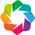

:NdOverlay   [Variable]
   :Curve   [Date]   (value)

In [ ]:
hv.extension('bokeh')
stock_data.hvplot(y= ['adx','plus_di','minus_di'])

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
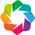

:Curve   [Date]   (rsi_09)

In [ ]:
hv.extension('bokeh')
stock_data['rsi_09'].hvplot()

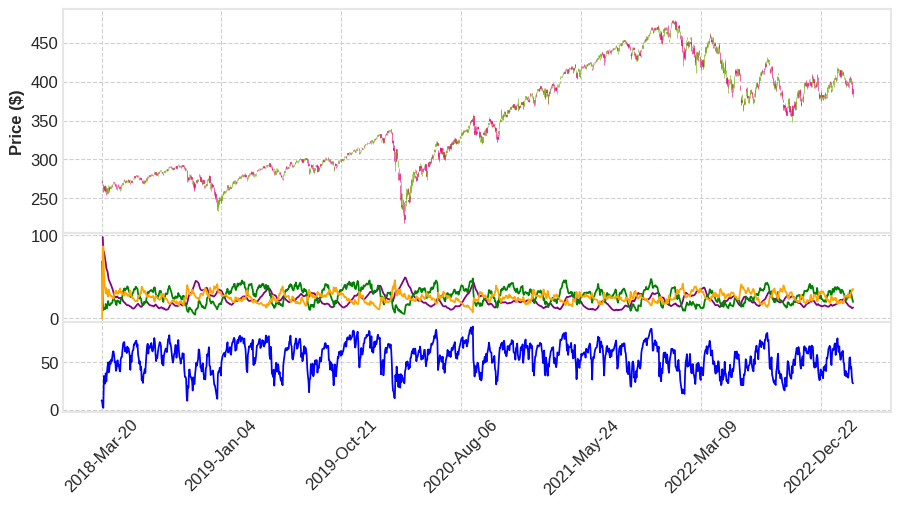

In [ ]:
spy_indicators = [mpl.make_addplot(stock_data[['adx']], panel=1, color = 'purple', secondary_y=False),
                  mpl.make_addplot(stock_data[['plus_di']], panel=1, color = 'green', secondary_y=False),
                  mpl.make_addplot(stock_data[['minus_di']], panel=1, color = 'orange', secondary_y=False),
                  mpl.make_addplot(stock_data['rsi_09'], panel = 2, color = 'blue', secondary_y=False)
]

fig, axes = mpl.plot(stock_data,
                     volume_panel = 1,
                     figratio= (2,1),
                     figscale=1,
                     type='candle',
                     style='binance',
                     ylabel='Price ($)',
                     addplot = spy_indicators,
                     returnfig=True)

In [ ]:
# Create a column to hold the trading signal
spy_data['Signal']= 0.0

In [ ]:
spy_data['Signal'][short_window:] = np.where(
    spy_data['SMA50'][short_window:] > spy_data['SMA100'][short_window:], 1.0,0.0
)

In [ ]:
spy_data.tail()

,Close,SMA50,SMA100,Signal
Date,,,,
2023-03-07,398.269989,398.3068,392.6649,1.0
2023-03-08,398.920013,398.6708,393.0885,1.0
2023-03-09,391.559998,398.8438,393.3444,1.0
2023-03-10,385.910004,398.9340,393.6272,1.0
2023-03-13,385.359985,399.1080,393.8126,1.0


In [ ]:
import matplotlib.pyplot as plt


In [ ]:
# spy_data['Signal'][50:] = np.where(spy_data['SMA50'][50:] > spy_data['SMA100'][50:], 1, -1)


In [ ]:
spy_data['Position'] = spy_data['Signal'].diff()

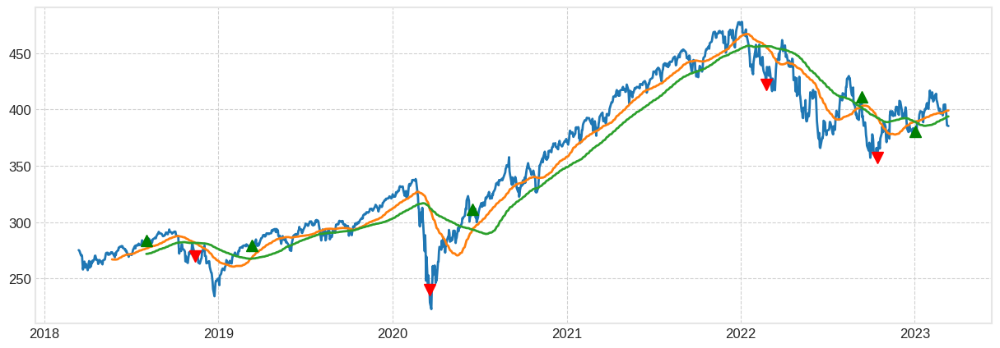

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(spy_data['Close'])
plt.plot(spy_data['SMA50'])
plt.plot(spy_data['SMA100'])
plt.plot(spy_data.loc[spy_data.Position == 1].index, spy_data.Close[spy_data.Position == 1], '^', markersize=10, color='green')
plt.plot(spy_data.loc[spy_data.Position == -1].index, spy_data.Close[spy_data.Position == -1], 'v', markersize=10, color='red')
plt.show()

In [ ]:
spy_data.loc['2020-01-01':'2020-04-01']

,Close,SMA50,SMA100,Signal,Position
Date,,,,,
2020-01-02,324.869995,312.254999,303.325999,1.0,0.0
2020-01-03,322.410004,312.722999,303.669399,1.0,0.0
2020-01-06,323.640015,313.198199,303.980299,1.0,0.0
2020-01-07,322.730011,313.645399,304.368599,1.0,0.0
2020-01-08,324.450012,314.102399,304.766599,1.0,0.0
2020-01-09,326.649994,314.569399,305.144599,1.0,0.0
2020-01-10,325.709991,315.019399,305.478399,1.0,0.0
2020-01-13,327.950012,315.495599,305.857000,1.0,0.0
2020-01-14,327.450012,315.978000,306.207000,1.0,0.0


In [ ]:
df = spy_data.reset_index()

In [ ]:
df.tail()

,Date,Close,SMA50,SMA100,Signal,Position
1253,2023-03-07,398.269989,398.3068,392.6649,1.0,0.0
1254,2023-03-08,398.920013,398.6708,393.0885,1.0,0.0
1255,2023-03-09,391.559998,398.8438,393.3444,1.0,0.0
1256,2023-03-10,385.910004,398.9340,393.6272,1.0,0.0
1257,2023-03-13,385.359985,399.1080,393.8126,1.0,0.0


In [ ]:
# Start using prophet
#Remane the features:
df = df.rename(columns={'Date': 'ds', 'Close':'y'})

#review data
df.head()


,ds,y,SMA50,SMA100,Signal,Position
0,2018-03-14,275.299988,NaN,NaN,0.0,NaN
1,2018-03-15,275.000000,NaN,NaN,0.0,0.0
2,2018-03-16,274.200012,NaN,NaN,0.0,0.0
3,2018-03-19,270.489990,NaN,NaN,0.0,0.0
4,2018-03-20,270.950012,NaN,NaN,0.0,0.0


In [ ]:
# Drop NANs
df = df.dropna()

In [ ]:
prophet = Prophet(growth='linear')
prophet

In [ ]:
prophet.fit(df)

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpd3j4i9p5/lnlxl59g.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpd3j4i9p5/u75ion5p.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.9/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7078', 'data', 'file=/tmp/tmpd3j4i9p5/lnlxl59g.json', 'init=/tmp/tmpd3j4i9p5/u75ion5p.json', 'output', 'file=/tmp/tmpd3j4i9p5/prophet_model1ydvvc3v/prophet_model-20230314011227.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
01:12:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
01:12:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [ ]:
future_30_days = prophet.make_future_dataframe(periods=30, freq='D')

In [ ]:
future_30_days.head()

,ds
0,2018-08-03
1,2018-08-06
2,2018-08-07
3,2018-08-08
4,2018-08-09


In [ ]:
forecast = prophet.predict(future_30_days)
display(forecast.head())

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2018-08-03,297.415075,283.398634,311.135708,297.415075,297.415075,0.051692,0.051692,0.051692,3.341819,3.341819,3.341819,-3.290127,-3.290127,-3.290127,0.0,0.0,0.0,297.466767
1,2018-08-06,296.563945,283.443915,311.618356,296.563945,296.563945,0.475049,0.475049,0.475049,3.433661,3.433661,3.433661,-2.958612,-2.958612,-2.958612,0.0,0.0,0.0,297.038994
2,2018-08-07,296.280235,282.799846,311.009806,296.280235,296.280235,0.753286,0.753286,0.753286,3.583578,3.583578,3.583578,-2.830291,-2.830291,-2.830291,0.0,0.0,0.0,297.033521
3,2018-08-08,295.996525,282.950507,310.500865,295.996525,295.996525,0.870772,0.870772,0.870772,3.564171,3.564171,3.564171,-2.693399,-2.693399,-2.693399,0.0,0.0,0.0,296.867297
4,2018-08-09,295.712815,283.027253,310.975985,295.712815,295.712815,0.946404,0.946404,0.946404,3.495074,3.495074,3.495074,-2.548670,-2.548670,-2.548670,0.0,0.0,0.0,296.659219


In [ ]:
forecast = forecast.set_index('ds')
forecast.head()

,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
ds,,,,,,,,,,,,,,,,,,
2018-08-03,297.415075,283.398634,311.135708,297.415075,297.415075,0.051692,0.051692,0.051692,3.341819,3.341819,3.341819,-3.290127,-3.290127,-3.290127,0.0,0.0,0.0,297.466767
2018-08-06,296.563945,283.443915,311.618356,296.563945,296.563945,0.475049,0.475049,0.475049,3.433661,3.433661,3.433661,-2.958612,-2.958612,-2.958612,0.0,0.0,0.0,297.038994
2018-08-07,296.280235,282.799846,311.009806,296.280235,296.280235,0.753286,0.753286,0.753286,3.583578,3.583578,3.583578,-2.830291,-2.830291,-2.830291,0.0,0.0,0.0,297.033521
2018-08-08,295.996525,282.950507,310.500865,295.996525,295.996525,0.870772,0.870772,0.870772,3.564171,3.564171,3.564171,-2.693399,-2.693399,-2.693399,0.0,0.0,0.0,296.867297
2018-08-09,295.712815,283.027253,310.975985,295.712815,295.712815,0.946404,0.946404,0.946404,3.495074,3.495074,3.495074,-2.548670,-2.548670,-2.548670,0.0,0.0,0.0,296.659219


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
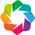

:NdOverlay   [Variable]
   :Curve   [ds]   (value)

In [ ]:
hv.extension('bokeh')
forecast[['trend','yhat_lower','yhat_upper', 'yhat']].iloc[-100:,:].hvplot()

In [ ]:
df


,ds,y,SMA50,SMA100,Signal,Position
99,2018-08-03,283.600006,276.794999,271.926799,1.0,1.0
100,2018-08-06,284.640015,277.031799,272.020200,1.0,0.0
101,2018-08-07,285.579987,277.300399,272.125999,1.0,0.0
102,2018-08-08,285.459991,277.629199,272.238599,1.0,0.0
103,2018-08-09,285.070007,277.878400,272.384399,1.0,0.0
...,...,...,...,...,...,...
1253,2023-03-07,398.269989,398.306800,392.664900,1.0,0.0
1254,2023-03-08,398.920013,398.670800,393.088500,1.0,0.0
1255,2023-03-09,391.559998,398.843800,393.344400,1.0,0.0
1256,2023-03-10,385.910004,398.934000,393.627200,1.0,0.0


In [ ]:
from sklearn.metrics import mean_absolute_error, mean_squared_error

In [ ]:
# Spliting the Data so we can back test
split_fraction = 0.8
spy_split = int(split_fraction * len(df))

train_data = df[:spy_split]
test_data = df[spy_split:]


In [ ]:
#data that were going to train
train_data = train_data.set_index('ds')
test_data = test_data.set_index('ds')


In [ ]:
#Make a Model
model = Prophet()

In [ ]:
train_data= train_data.reset_index()
train_data

,ds,y,SMA50,SMA100,Signal,Position
0,2018-08-03,283.600006,276.794999,271.926799,1.0,1.0
1,2018-08-06,284.640015,277.031799,272.020200,1.0,0.0
2,2018-08-07,285.579987,277.300399,272.125999,1.0,0.0
3,2018-08-08,285.459991,277.629199,272.238599,1.0,0.0
4,2018-08-09,285.070007,277.878400,272.384399,1.0,0.0
...,...,...,...,...,...,...
922,2022-04-01,452.920013,440.151003,453.064902,0.0,0.0
923,2022-04-04,456.799988,440.527403,452.959102,0.0,0.0
924,2022-04-05,451.029999,440.751203,452.833202,0.0,0.0
925,2022-04-06,446.519989,440.992203,452.660702,0.0,0.0


In [ ]:
test_data = test_data.reset_index()

In [ ]:
model = model.fit(train_data)

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpd3j4i9p5/b1_479ni.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpd3j4i9p5/ifcfrdba.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.9/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14', 'data', 'file=/tmp/tmpd3j4i9p5/b1_479ni.json', 'init=/tmp/tmpd3j4i9p5/ifcfrdba.json', 'output', 'file=/tmp/tmpd3j4i9p5/prophet_model7t_r_ud3/prophet_model-20230314011235.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
01:12:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
01:12:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [ ]:
from sklearn.metrics import mean_absolute_error, mean_squared_error

mae = mean_absolute_error(test_data['y'], forecast['yhat'][-len(test_data):])
rmse = mean_squared_error(test_data['y'], forecast['yhat'][-len(test_data):], squared=False)

print('MAE:', mae)
print('RMSE:', rmse)


MAE: 18.202939472028206
RMSE: 21.945309629851668


In [ ]:
future = model.make_future_dataframe(periods=len(test_data))
forecast = model.predict(future)

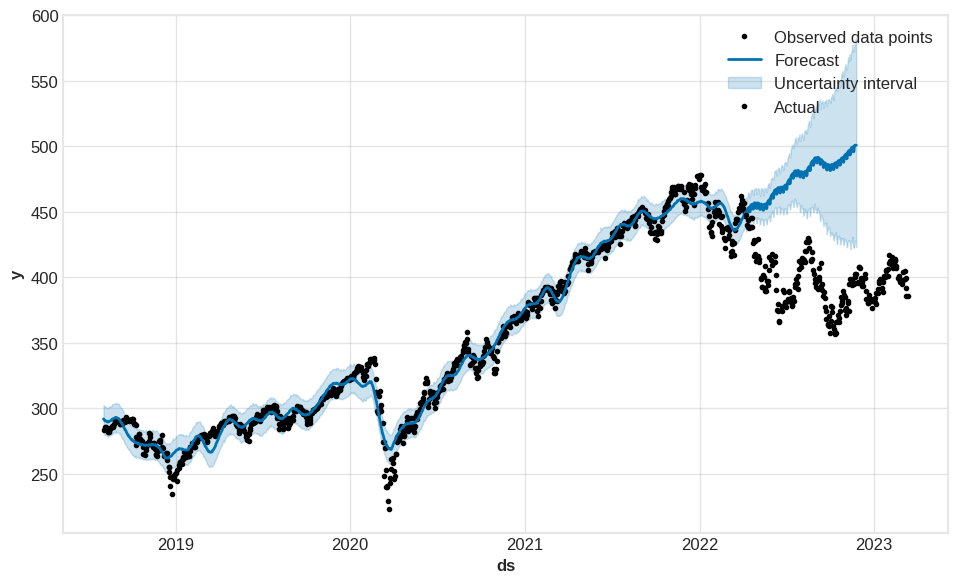

In [ ]:
fig = model.plot(forecast)
fig.gca().plot(test_data['ds'], test_data['y'], 'k.', label='Actual')
plt.legend()
plt.show()
